## Before you start

Let's make sure that we have access to GPU. We can use `nvidia-smi` command to do that. In case of any problems navigate to `Edit` -> `Notebook settings` -> `Hardware accelerator`, set it to `GPU`, and then click `Save`.

In [1]:
!nvidia-smi

Sun Nov 24 05:23:06 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   54C    P8              10W /  70W |      0MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [2]:
import os
HOME = os.getcwd()
print(HOME)

/content


## Install YOLOv8

⚠️ YOLOv8 is still under heavy development. Breaking changes are being introduced almost weekly. We strive to make our YOLOv8 notebooks work with the latest version of the library. Last tests took place on **18.01.2023** with version **YOLOv8.0.9**.

If you notice that our notebook behaves incorrectly - especially if you experience errors that prevent you from going through the tutorial - don't hesitate! Let us know and open an [issue](https://github.com/roboflow/notebooks/issues) on the Roboflow Notebooks repository.

YOLOv8 can be installed in two ways - from the source and via pip. This is because it is the first iteration of YOLO to have an official package.

In [3]:
# Pip install method (recommended)

!pip install ultralytics==8.0.196

from IPython import display
display.clear_output()

import ultralytics
ultralytics.checks()

Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 32.5/112.6 GB disk)


In [4]:
from ultralytics import YOLO

from IPython.display import display, Image

## CLI Basics

## Inference with Pre-trained COCO Model

### 💻 CLI

`yolo mode=predict` runs YOLOv8 inference on a variety of sources, downloading models automatically from the latest YOLOv8 release, and saving results to `runs/predict`.

In [5]:
%cd {HOME}
!yolo task=segment mode=predict model=yolov8s-seg.pt conf=0.25 source='https://media.roboflow.com/notebooks/examples/dog.jpeg'

/content
100% 22.8M/22.8M [00:00<00:00, 75.0MB/s]
/usr/local/lib/python3.10/dist-packages/ultralytics/nn/tasks.py:567: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  return t

/content


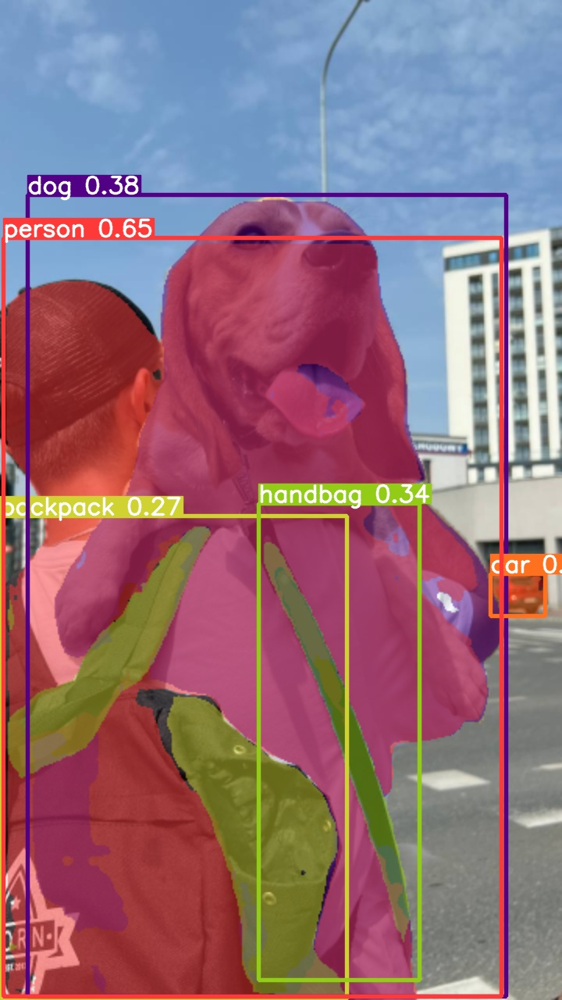

In [6]:
%cd {HOME}
Image(filename='runs/segment/predict/dog.jpeg', height=600)

### 🐍 Python SDK

The simplest way of simply using YOLOv8 directly in a Python environment.

In [7]:
!mkdir {HOME}/datasets
%cd {HOME}/datasets

!pip install roboflow --quiet

import roboflow\

roboflow.login()

rf = roboflow.Roboflow()

project = rf.workspace("working-pfnxt").project("pothole-detection-project-bayaq")
version = project.version(1)
dataset = version.download("yolov9")

/content/datasets
visit https://app.roboflow.com/auth-cli to get your authentication token.
Paste the authentication token here: ··········
loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to pothole-detection-project-1 in yolov9:: 100%|██████████| 888/888 [00:00<00:00, 6188.49it/s]


In [8]:
print(dataset.location)

/content/datasets/pothole-detection-project-1


## Custom Training

In [9]:
%cd {HOME}

!yolo task=segment \
      mode=train \
      model=yolov8s-seg.pt \
      data={dataset.location}/data.yaml \
      epochs=100 \
      imgsz=640 \
      batch=32 \
      lr0=0.001 \
      optimizer=AdamW \
      weight_decay=0.0005 \
      augment \
      patience=20

/content
/usr/local/lib/python3.10/dist-packages/ultralytics/nn/tasks.py:567: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  return torch.load(file, map_location='cpu'), file

In [10]:
!yolo task=segment mode=predict \
      model= runs/segment/train7/weights/best.pt  \
      source=/content/datasets/pothole-detection-project-1/test/images \
      imgsz=640 conf=0.25

/usr/local/lib/python3.10/dist-packages/ultralytics/nn/tasks.py:567: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  return torch.load(file, map_location='cpu'), file  # load


In [4]:
!pip install ultralytics
!pip install opencv-python
!pip install numpy
!pip install cvzone

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 887.3/887.3 kB 37.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for cvzone: filename=cvzone-1.6.1-py3-none-any.whl size=26298 sha256=388fdc5b9671270221e7ad6c968b59767ea921887592668009e44cccccc39946
  Stored in directory: /root/.cache/pip/wheels/2c/9f/b3/92e945ac4a71bf727a92463f38155cc5a4fa49c5010b38ec4c
Successfully built cvzone



0: 320x640 2 potholes, 15.1ms
Speed: 1.9ms preprocess, 15.1ms inference, 1.8ms postprocess per image at shape (1, 3, 320, 640)


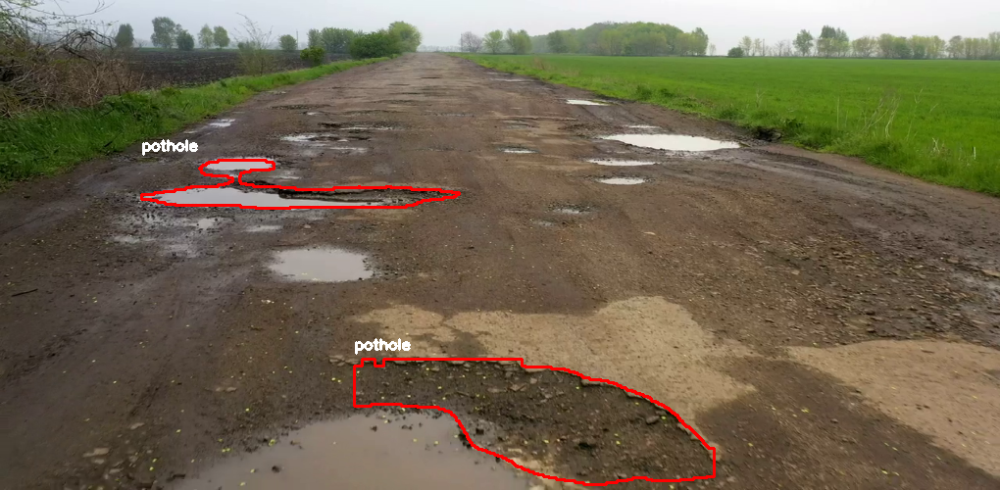


0: 320x640 2 potholes, 13.4ms
Speed: 2.7ms preprocess, 13.4ms inference, 2.5ms postprocess per image at shape (1, 3, 320, 640)


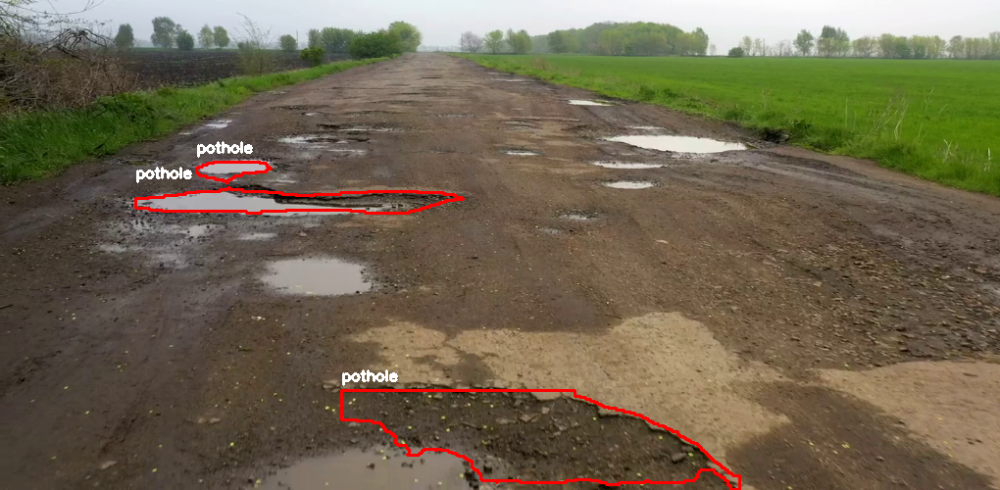


0: 320x640 1 pothole, 15.0ms
Speed: 2.5ms preprocess, 15.0ms inference, 2.9ms postprocess per image at shape (1, 3, 320, 640)


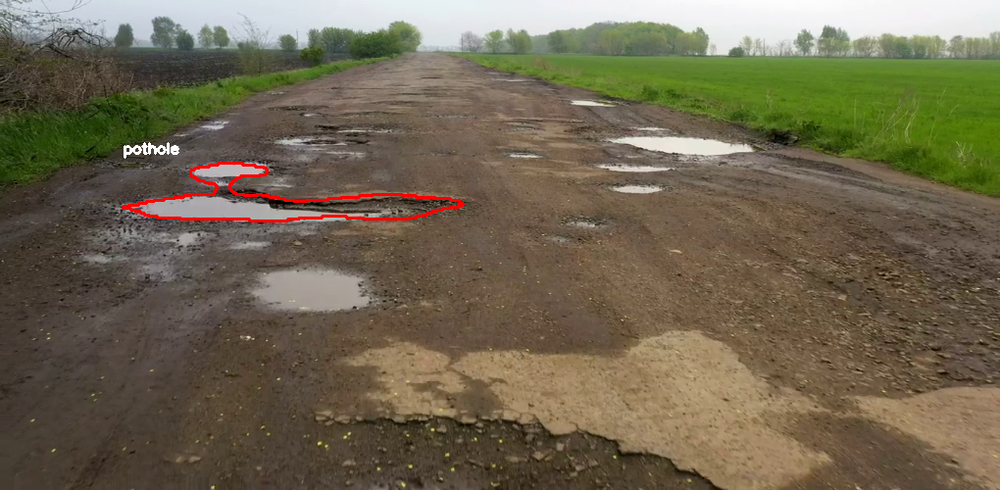


0: 320x640 5 potholes, 15.1ms
Speed: 2.4ms preprocess, 15.1ms inference, 2.9ms postprocess per image at shape (1, 3, 320, 640)


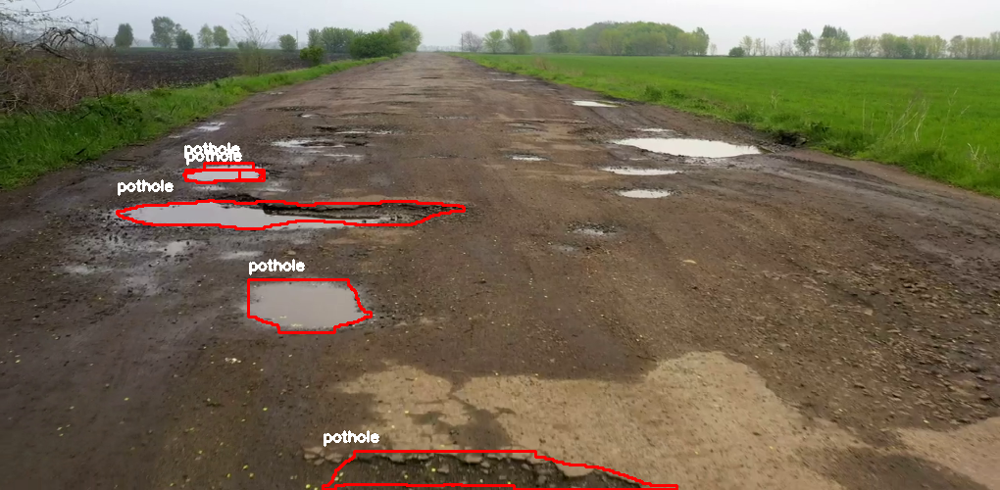


0: 320x640 1 pothole, 16.3ms
Speed: 3.6ms preprocess, 16.3ms inference, 2.4ms postprocess per image at shape (1, 3, 320, 640)


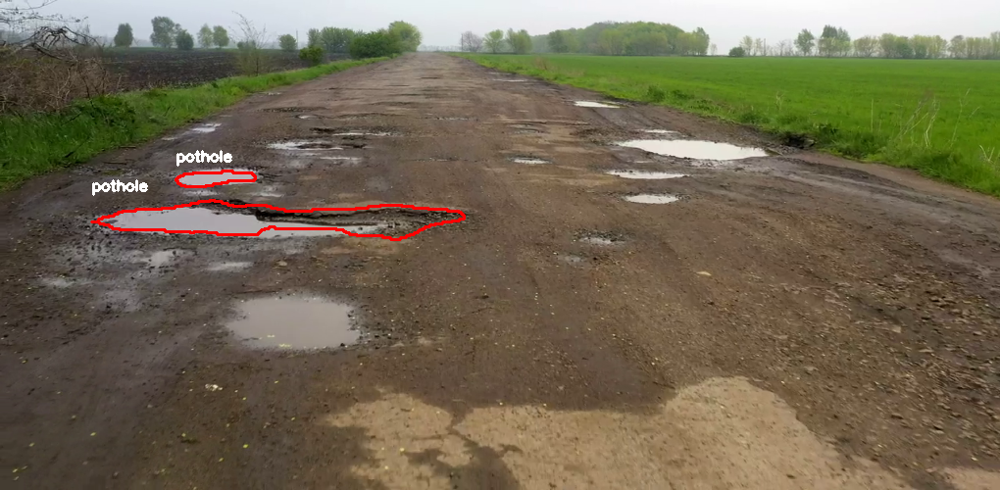


0: 320x640 1 pothole, 13.3ms
Speed: 2.6ms preprocess, 13.3ms inference, 2.3ms postprocess per image at shape (1, 3, 320, 640)


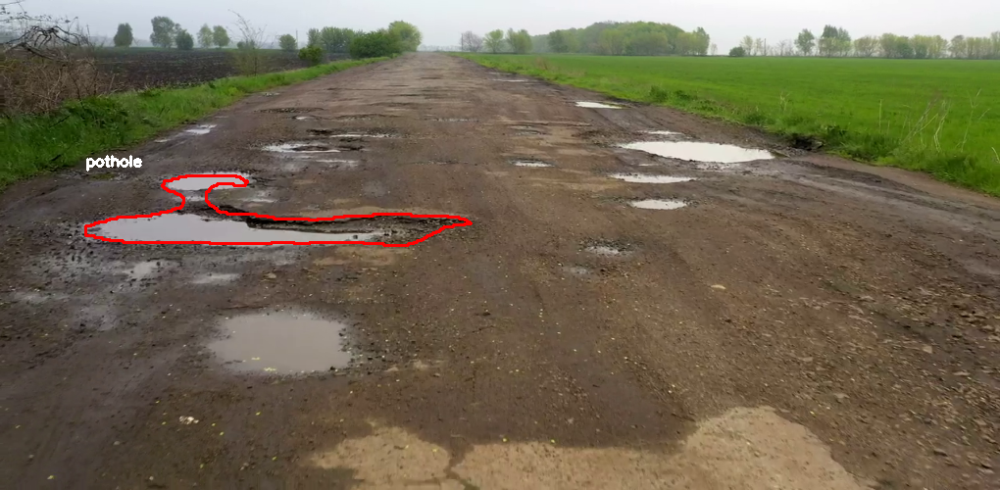


0: 320x640 3 potholes, 13.3ms
Speed: 2.5ms preprocess, 13.3ms inference, 2.4ms postprocess per image at shape (1, 3, 320, 640)


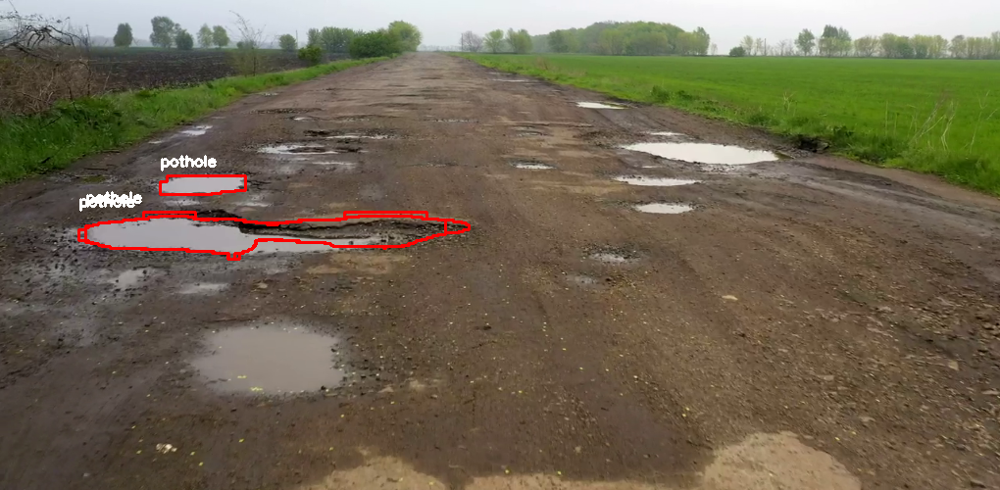


0: 320x640 4 potholes, 16.2ms
Speed: 4.5ms preprocess, 16.2ms inference, 2.4ms postprocess per image at shape (1, 3, 320, 640)


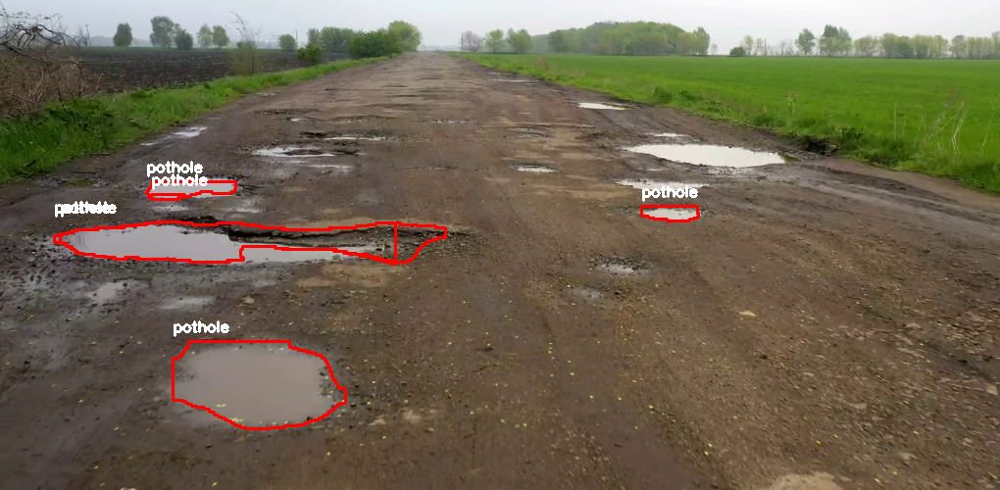


0: 320x640 2 potholes, 14.2ms
Speed: 4.4ms preprocess, 14.2ms inference, 2.8ms postprocess per image at shape (1, 3, 320, 640)


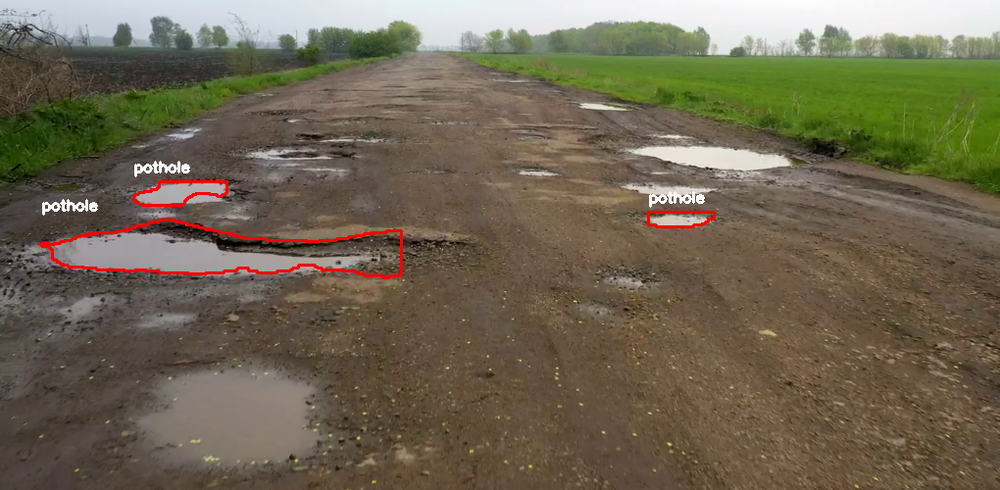


0: 320x640 3 potholes, 18.6ms
Speed: 2.5ms preprocess, 18.6ms inference, 5.6ms postprocess per image at shape (1, 3, 320, 640)


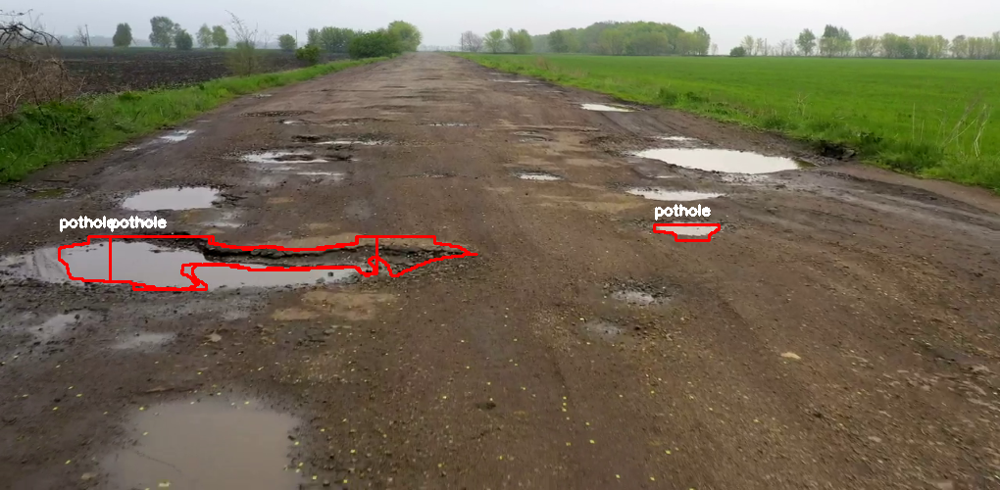


0: 320x640 2 potholes, 15.7ms
Speed: 2.5ms preprocess, 15.7ms inference, 2.4ms postprocess per image at shape (1, 3, 320, 640)


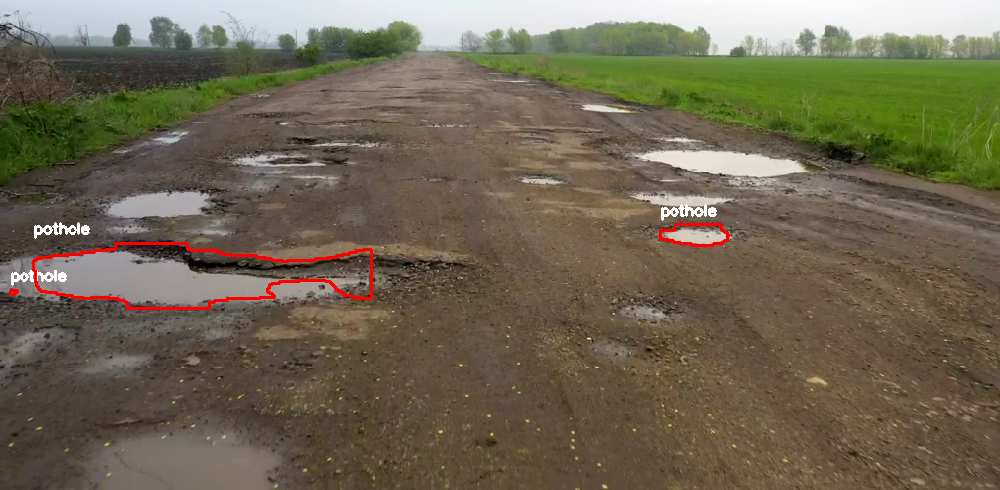


0: 320x640 3 potholes, 14.3ms
Speed: 4.6ms preprocess, 14.3ms inference, 2.5ms postprocess per image at shape (1, 3, 320, 640)


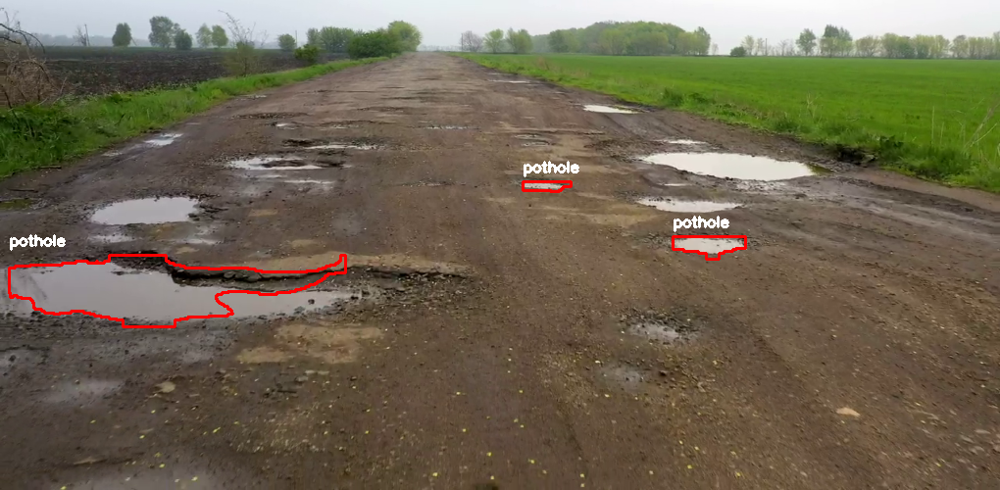


0: 320x640 2 potholes, 13.9ms
Speed: 2.4ms preprocess, 13.9ms inference, 2.8ms postprocess per image at shape (1, 3, 320, 640)


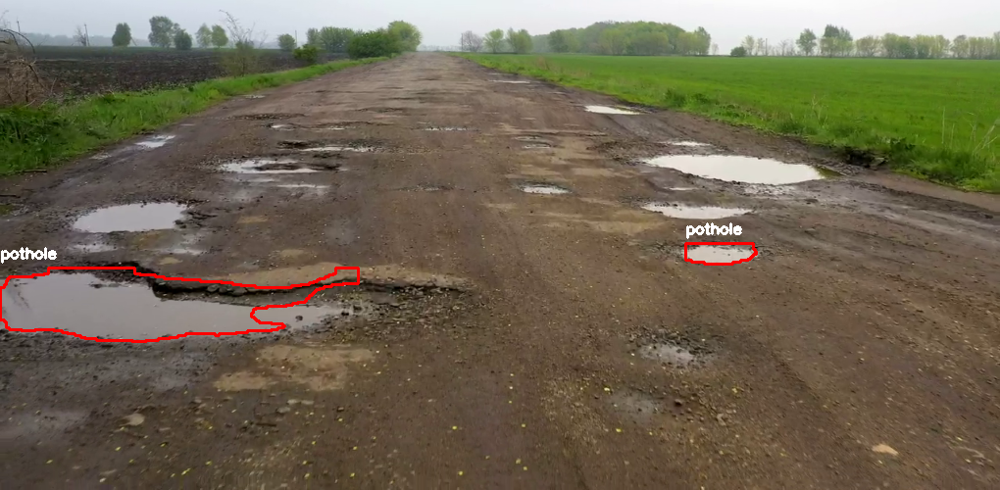


0: 320x640 1 pothole, 19.7ms
Speed: 2.6ms preprocess, 19.7ms inference, 2.8ms postprocess per image at shape (1, 3, 320, 640)


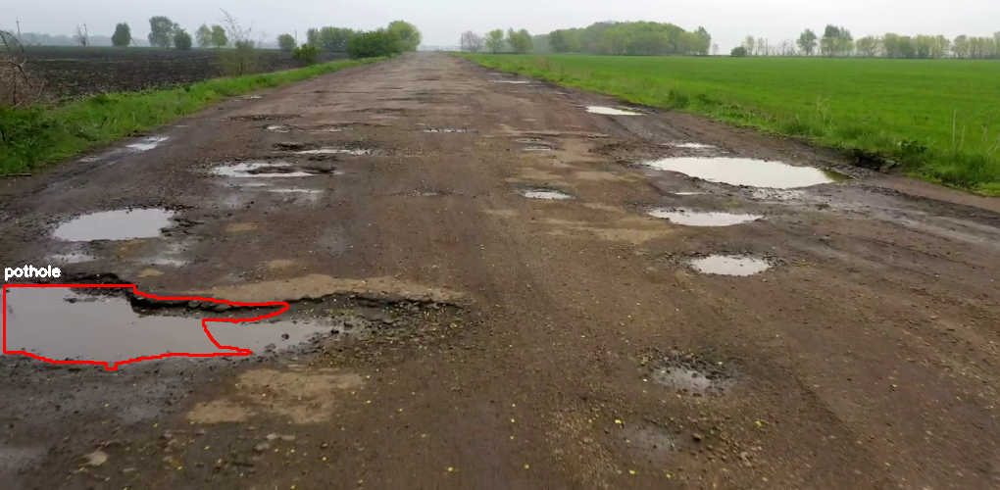


0: 320x640 1 pothole, 15.1ms
Speed: 4.3ms preprocess, 15.1ms inference, 3.0ms postprocess per image at shape (1, 3, 320, 640)


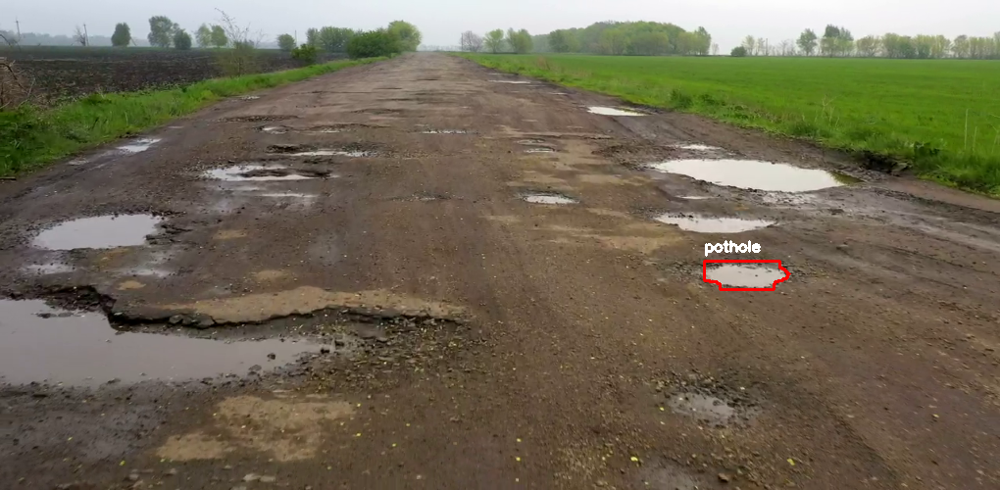


0: 320x640 3 potholes, 19.0ms
Speed: 2.5ms preprocess, 19.0ms inference, 4.8ms postprocess per image at shape (1, 3, 320, 640)


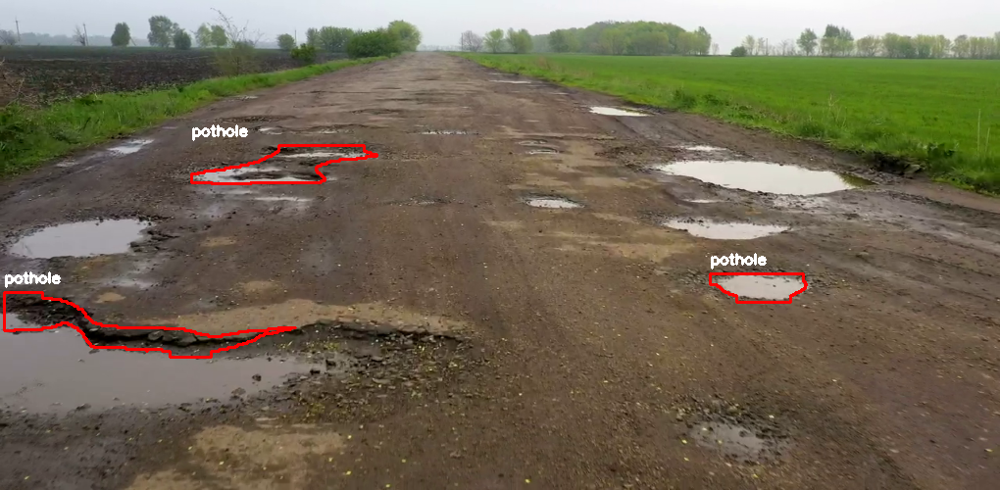


0: 320x640 5 potholes, 16.8ms
Speed: 6.7ms preprocess, 16.8ms inference, 4.6ms postprocess per image at shape (1, 3, 320, 640)


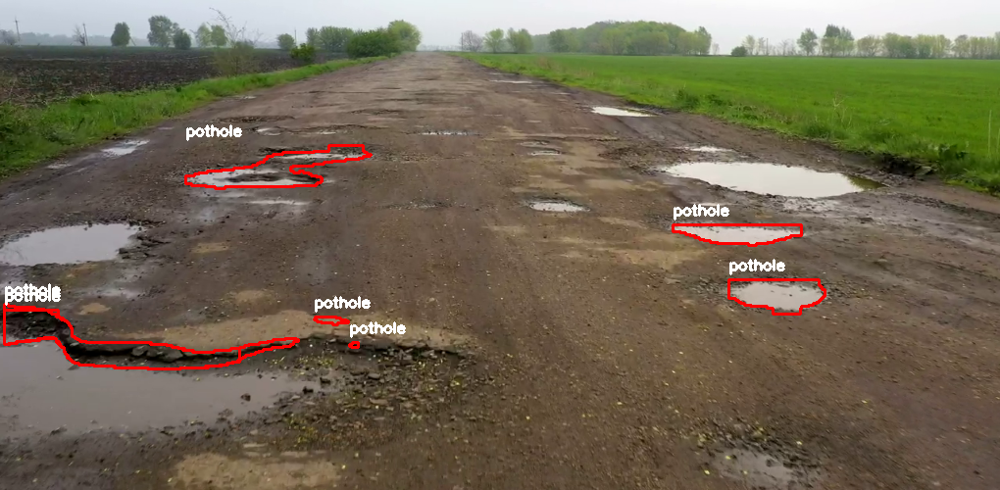


0: 320x640 4 potholes, 17.7ms
Speed: 6.7ms preprocess, 17.7ms inference, 2.4ms postprocess per image at shape (1, 3, 320, 640)


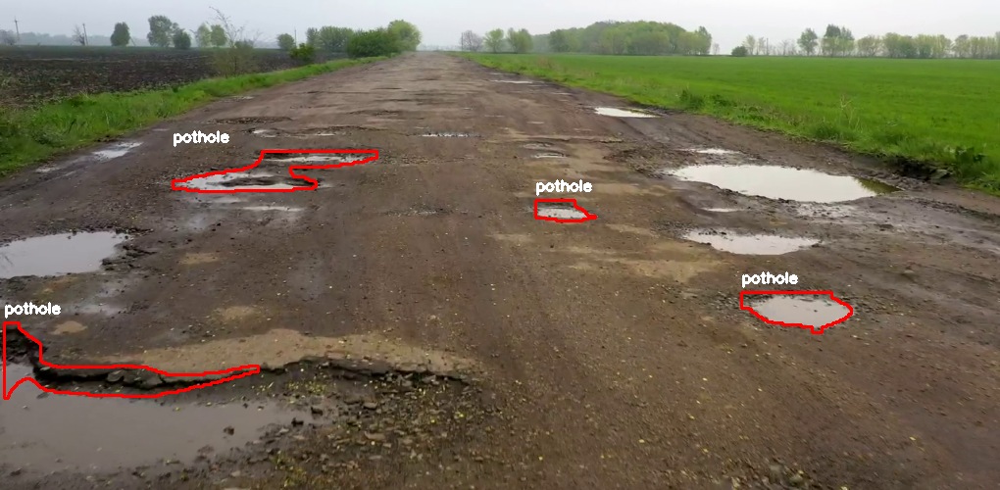


0: 320x640 2 potholes, 22.7ms
Speed: 5.5ms preprocess, 22.7ms inference, 5.2ms postprocess per image at shape (1, 3, 320, 640)


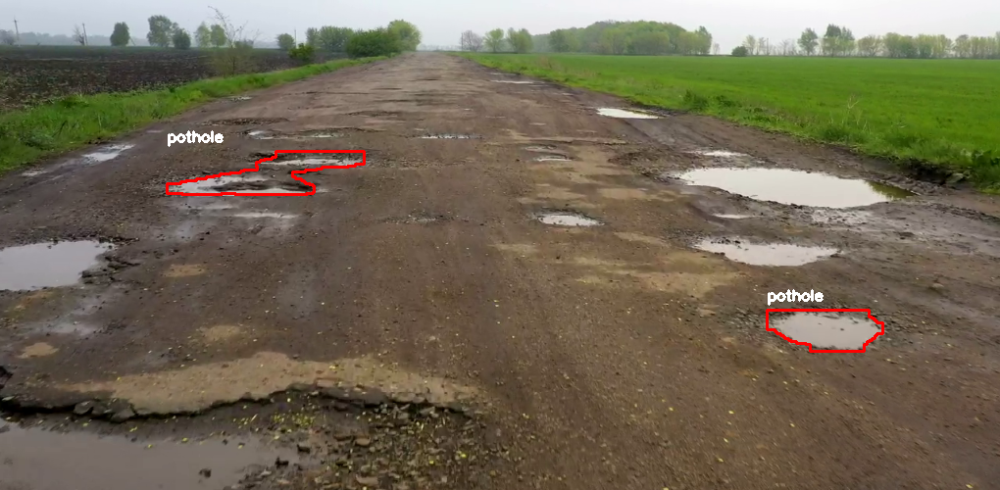


0: 320x640 6 potholes, 23.3ms
Speed: 2.8ms preprocess, 23.3ms inference, 7.6ms postprocess per image at shape (1, 3, 320, 640)


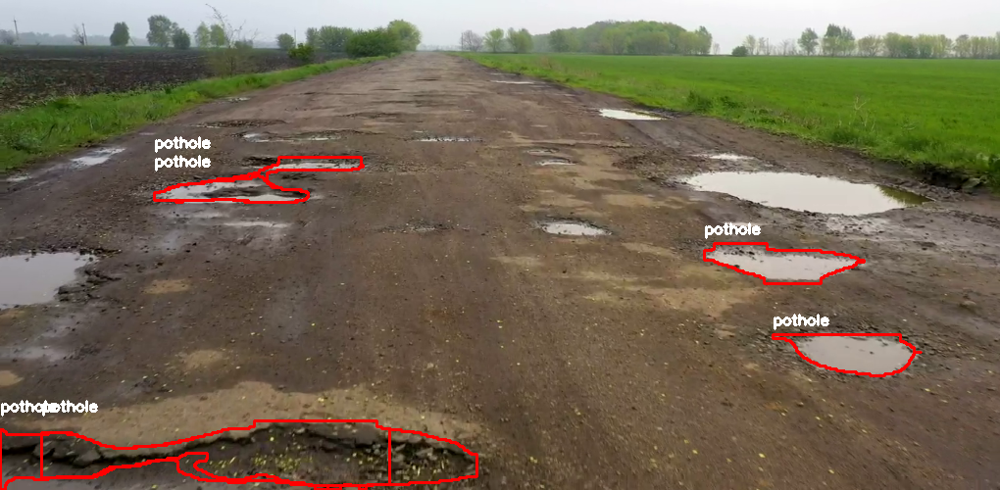


0: 320x640 2 potholes, 17.5ms
Speed: 2.6ms preprocess, 17.5ms inference, 4.4ms postprocess per image at shape (1, 3, 320, 640)


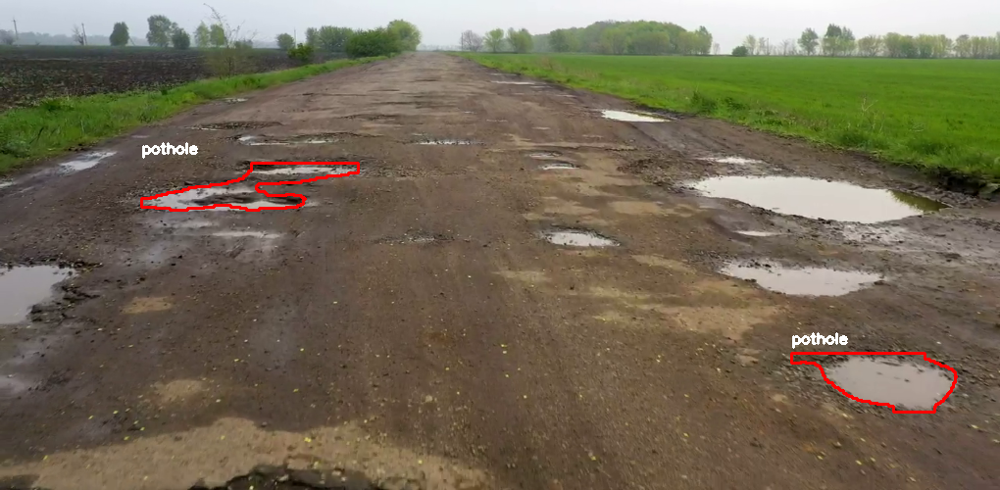


0: 320x640 5 potholes, 17.9ms
Speed: 2.8ms preprocess, 17.9ms inference, 2.4ms postprocess per image at shape (1, 3, 320, 640)


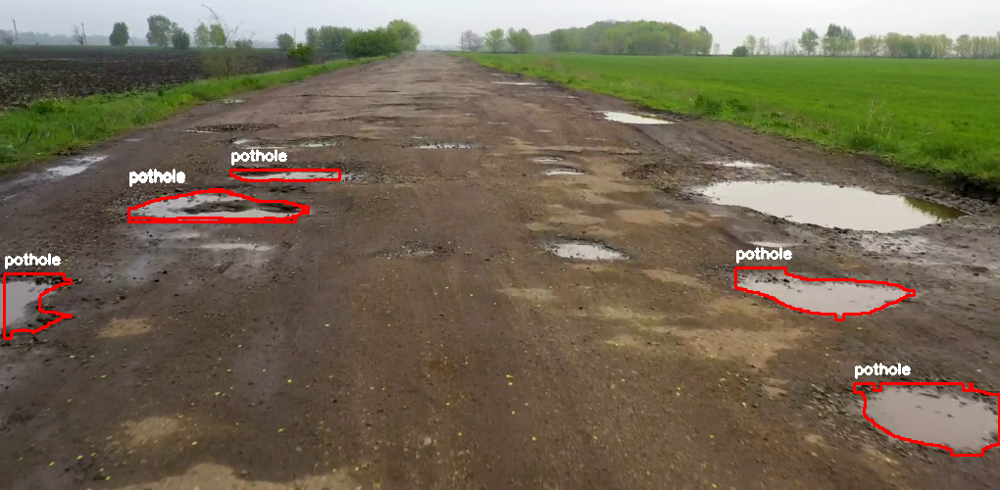


0: 320x640 6 potholes, 15.2ms
Speed: 2.6ms preprocess, 15.2ms inference, 2.4ms postprocess per image at shape (1, 3, 320, 640)


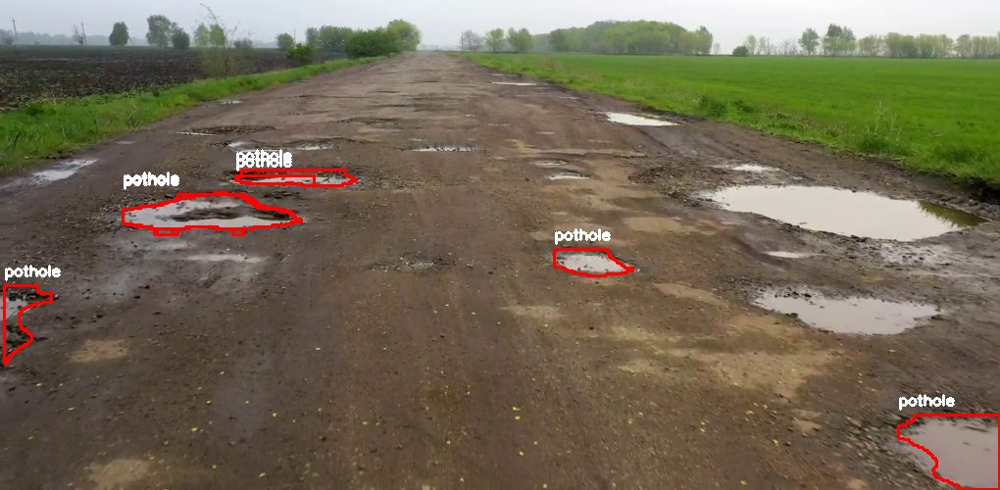


0: 320x640 1 pothole, 24.7ms
Speed: 2.5ms preprocess, 24.7ms inference, 5.3ms postprocess per image at shape (1, 3, 320, 640)


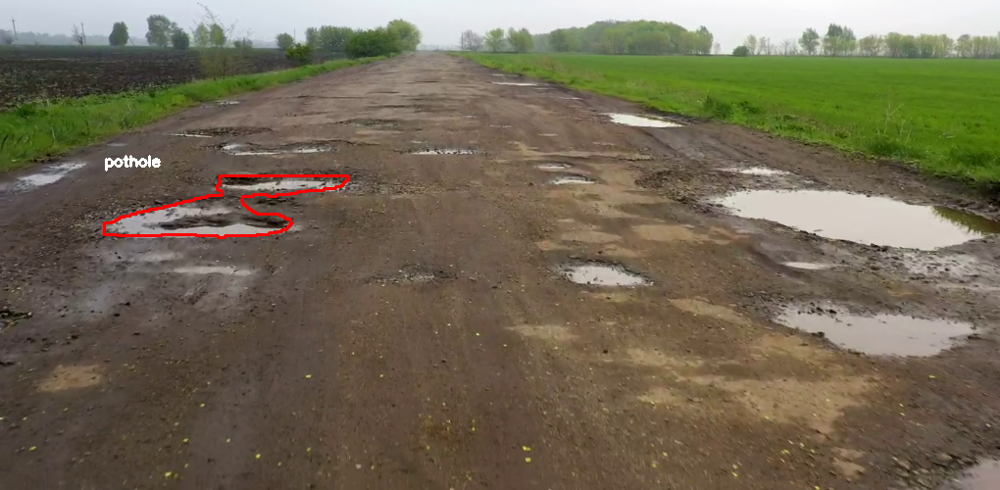


0: 320x640 1 pothole, 23.7ms
Speed: 2.6ms preprocess, 23.7ms inference, 2.4ms postprocess per image at shape (1, 3, 320, 640)


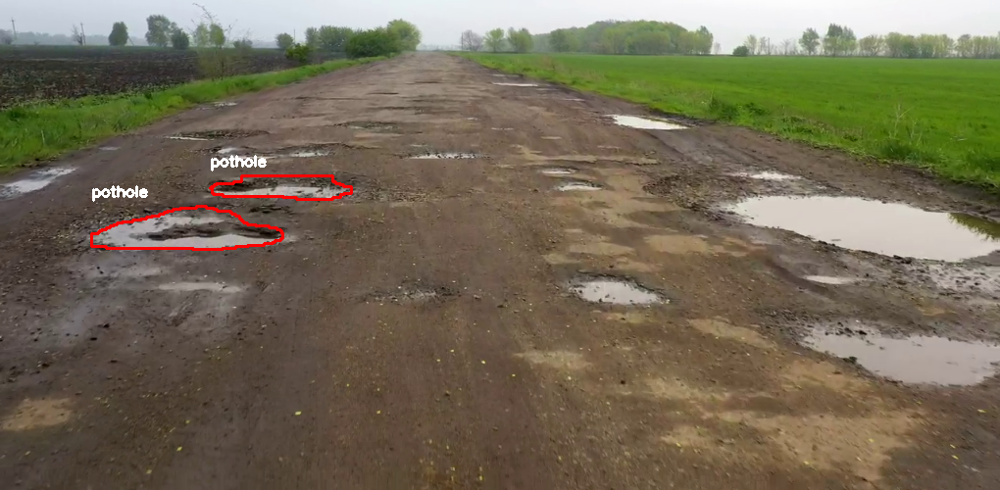


0: 320x640 2 potholes, 24.1ms
Speed: 2.5ms preprocess, 24.1ms inference, 2.5ms postprocess per image at shape (1, 3, 320, 640)


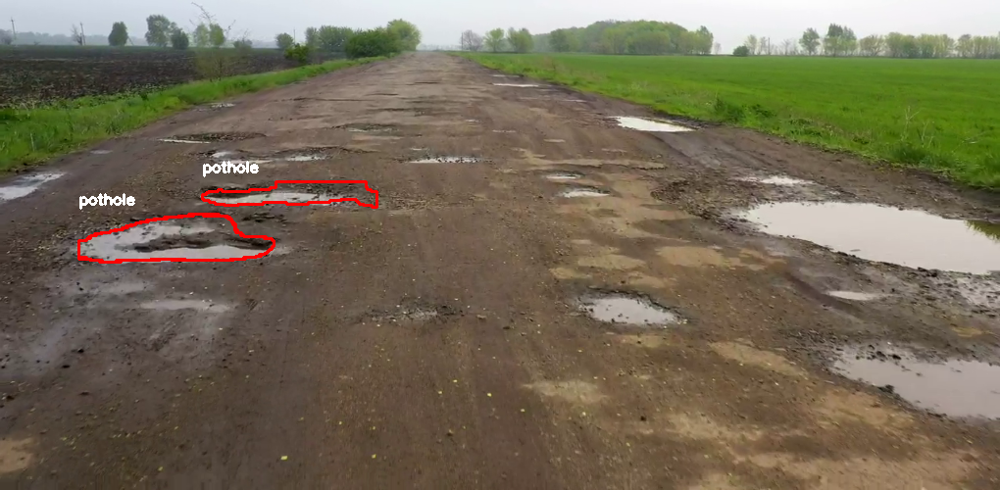


0: 320x640 1 pothole, 23.5ms
Speed: 5.0ms preprocess, 23.5ms inference, 2.6ms postprocess per image at shape (1, 3, 320, 640)


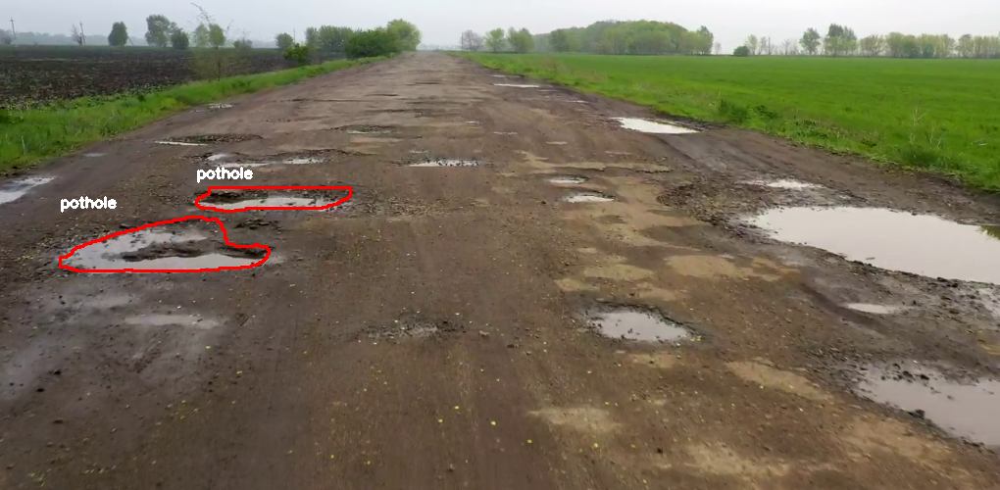


0: 320x640 1 pothole, 14.8ms
Speed: 7.6ms preprocess, 14.8ms inference, 6.5ms postprocess per image at shape (1, 3, 320, 640)


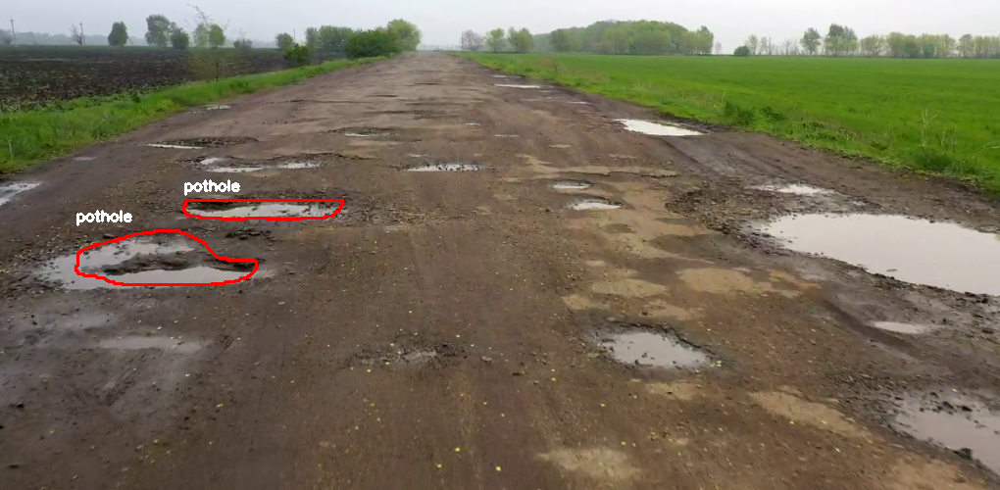


0: 320x640 2 potholes, 18.0ms
Speed: 2.5ms preprocess, 18.0ms inference, 4.5ms postprocess per image at shape (1, 3, 320, 640)


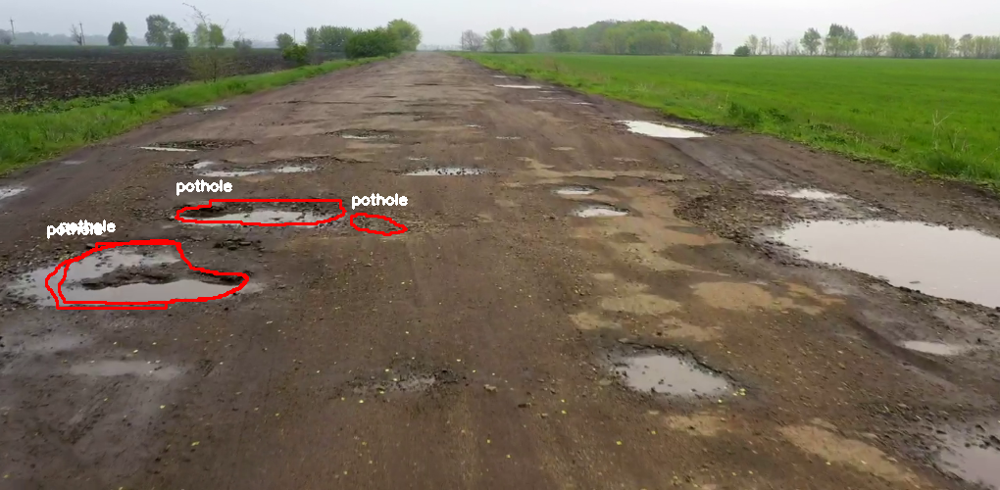


0: 320x640 2 potholes, 22.4ms
Speed: 6.8ms preprocess, 22.4ms inference, 2.6ms postprocess per image at shape (1, 3, 320, 640)


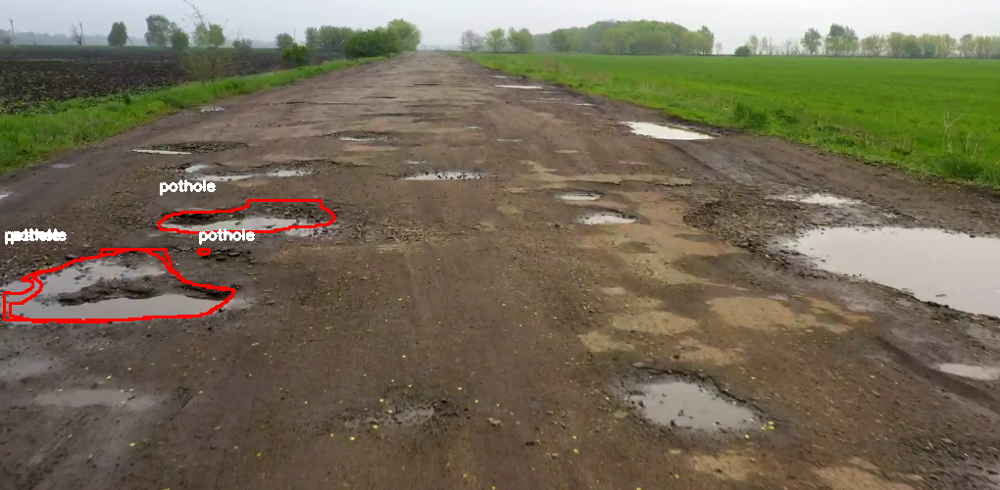


0: 320x640 3 potholes, 22.2ms
Speed: 2.8ms preprocess, 22.2ms inference, 2.6ms postprocess per image at shape (1, 3, 320, 640)


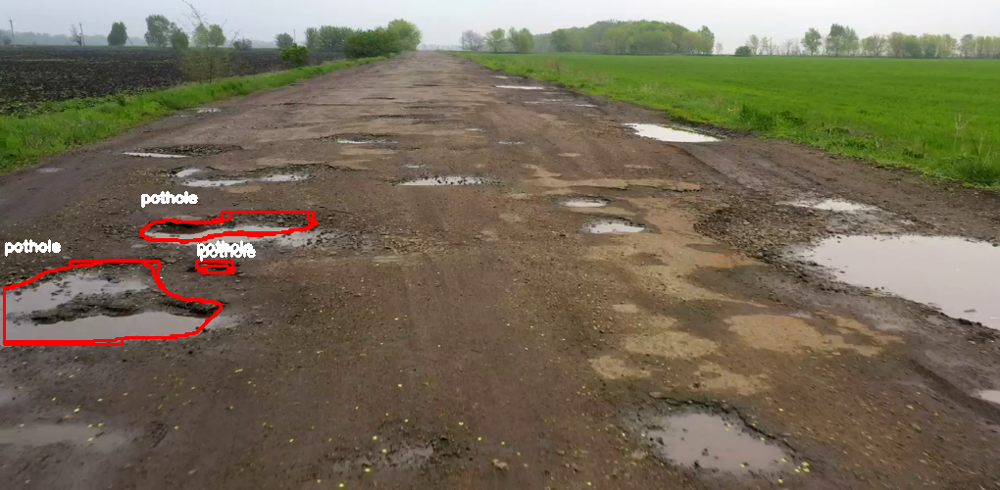


0: 320x640 2 potholes, 22.6ms
Speed: 5.5ms preprocess, 22.6ms inference, 3.0ms postprocess per image at shape (1, 3, 320, 640)


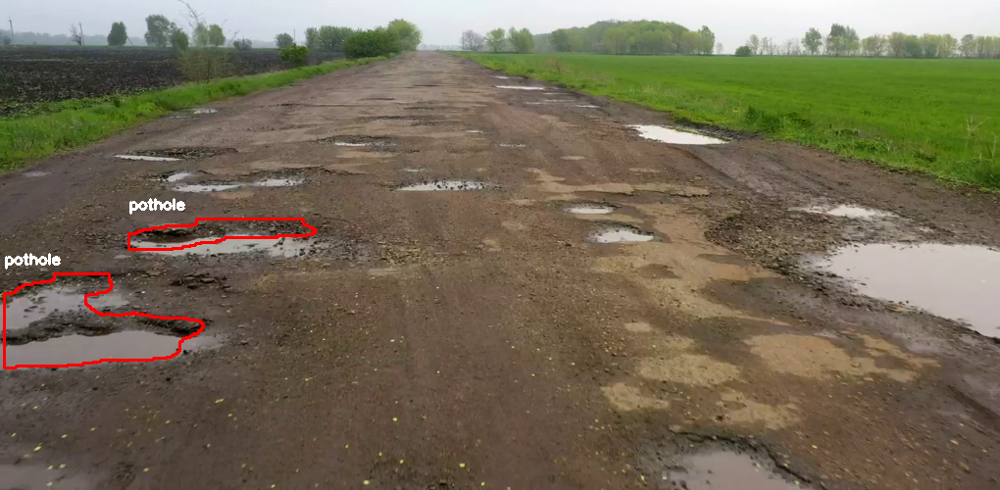


0: 320x640 1 pothole, 22.8ms
Speed: 2.7ms preprocess, 22.8ms inference, 3.6ms postprocess per image at shape (1, 3, 320, 640)


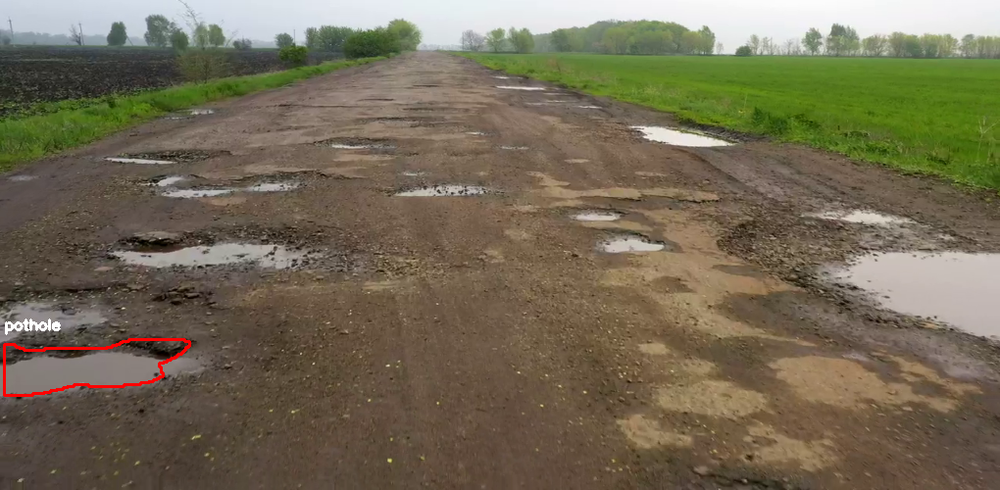


0: 320x640 1 pothole, 21.4ms
Speed: 2.6ms preprocess, 21.4ms inference, 2.5ms postprocess per image at shape (1, 3, 320, 640)


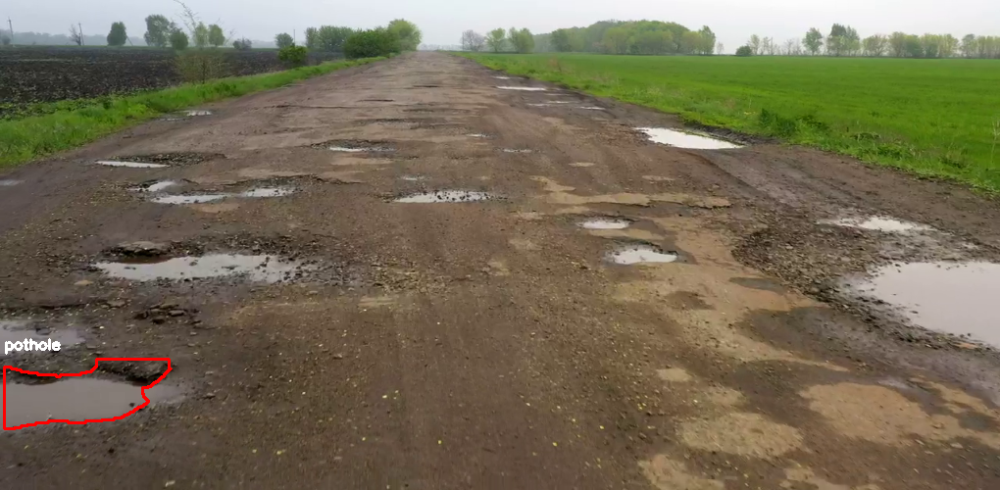


0: 320x640 2 potholes, 22.5ms
Speed: 2.7ms preprocess, 22.5ms inference, 4.8ms postprocess per image at shape (1, 3, 320, 640)


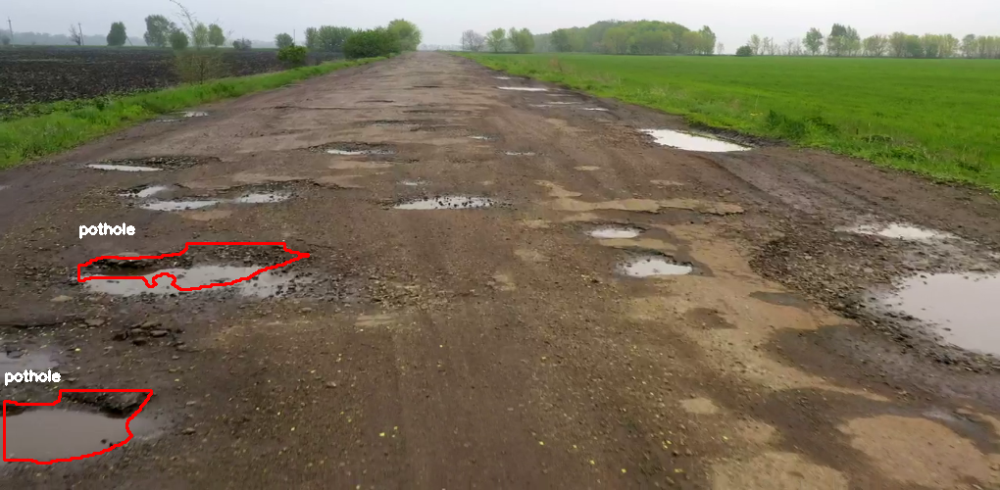


0: 320x640 1 pothole, 20.7ms
Speed: 2.6ms preprocess, 20.7ms inference, 2.5ms postprocess per image at shape (1, 3, 320, 640)


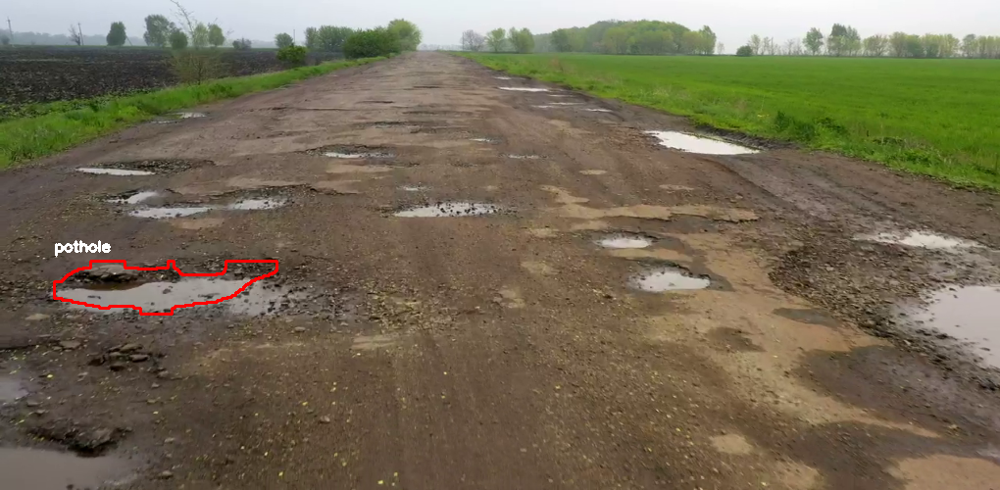


0: 320x640 2 potholes, 16.0ms
Speed: 2.5ms preprocess, 16.0ms inference, 2.6ms postprocess per image at shape (1, 3, 320, 640)


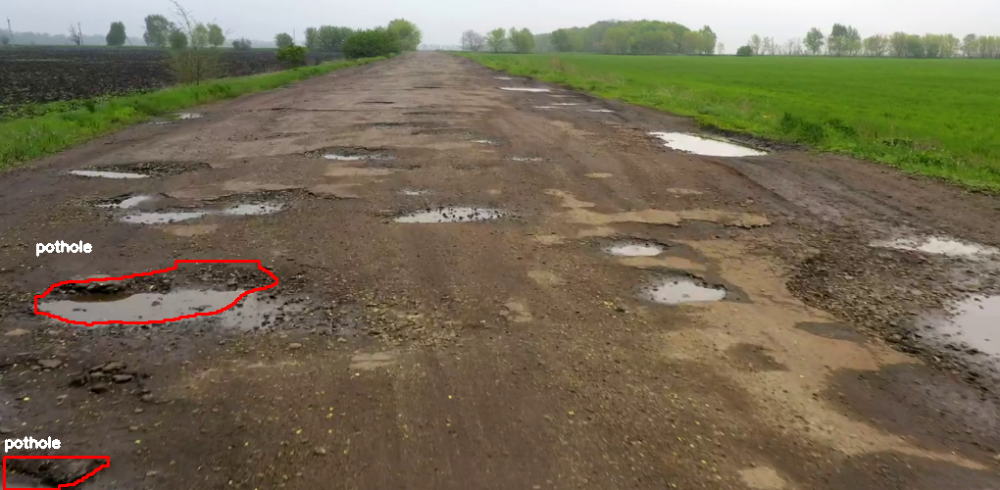


0: 320x640 2 potholes, 18.8ms
Speed: 2.5ms preprocess, 18.8ms inference, 2.7ms postprocess per image at shape (1, 3, 320, 640)


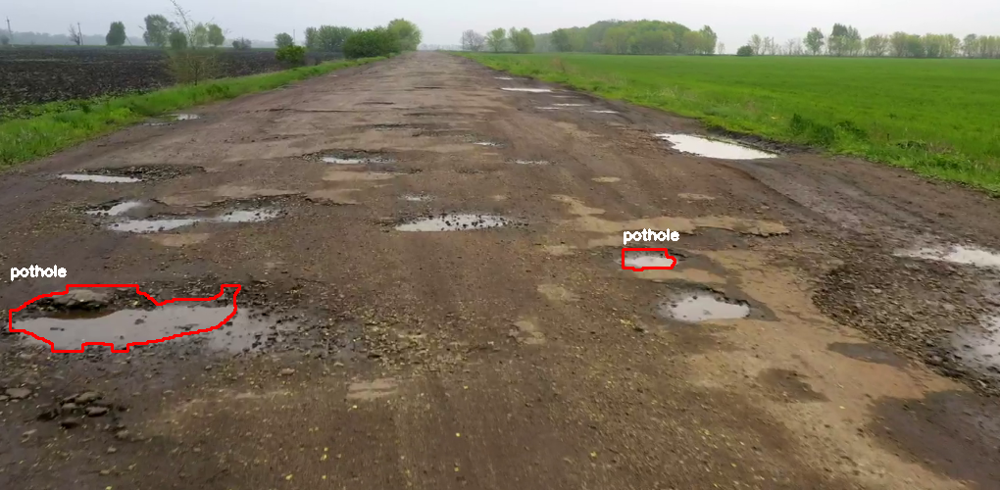


0: 320x640 4 potholes, 13.4ms
Speed: 4.1ms preprocess, 13.4ms inference, 2.4ms postprocess per image at shape (1, 3, 320, 640)


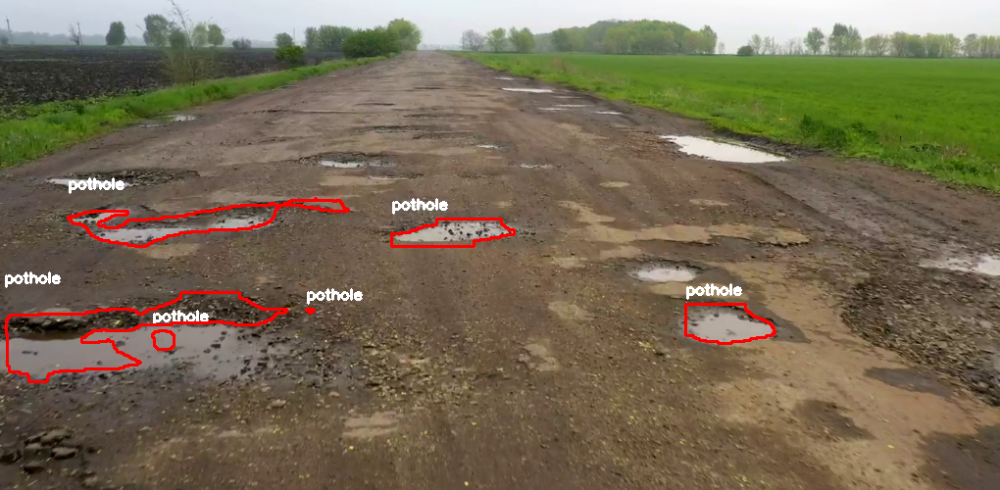


0: 320x640 3 potholes, 13.3ms
Speed: 2.4ms preprocess, 13.3ms inference, 2.4ms postprocess per image at shape (1, 3, 320, 640)


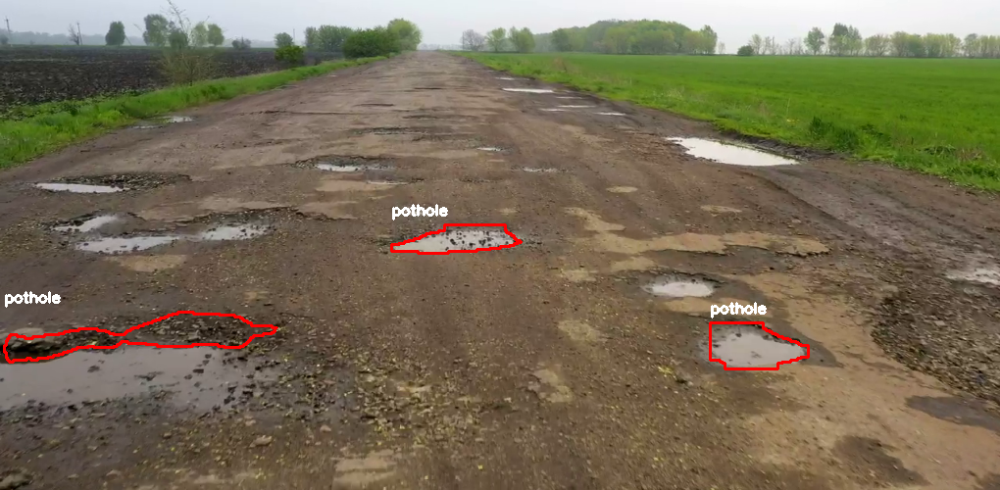


0: 320x640 3 potholes, 15.2ms
Speed: 2.5ms preprocess, 15.2ms inference, 2.3ms postprocess per image at shape (1, 3, 320, 640)


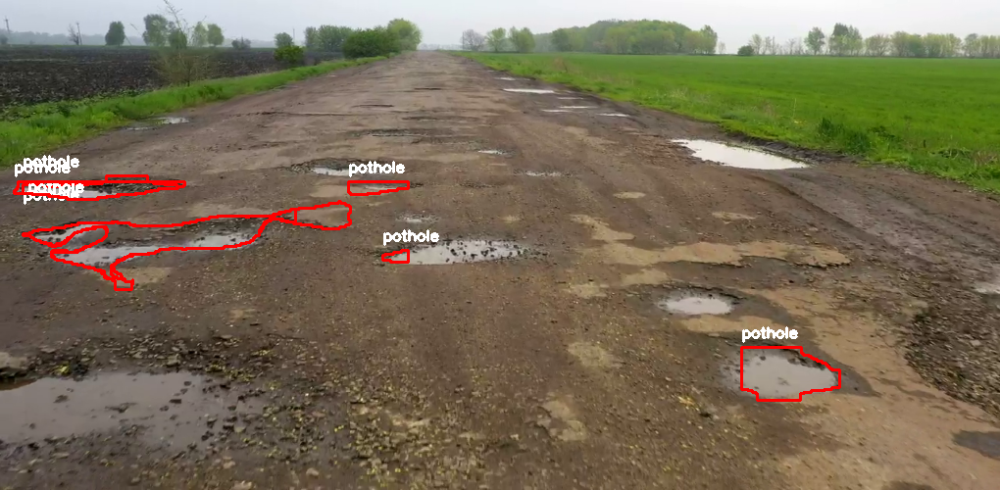


0: 320x640 1 pothole, 14.6ms
Speed: 3.2ms preprocess, 14.6ms inference, 4.4ms postprocess per image at shape (1, 3, 320, 640)


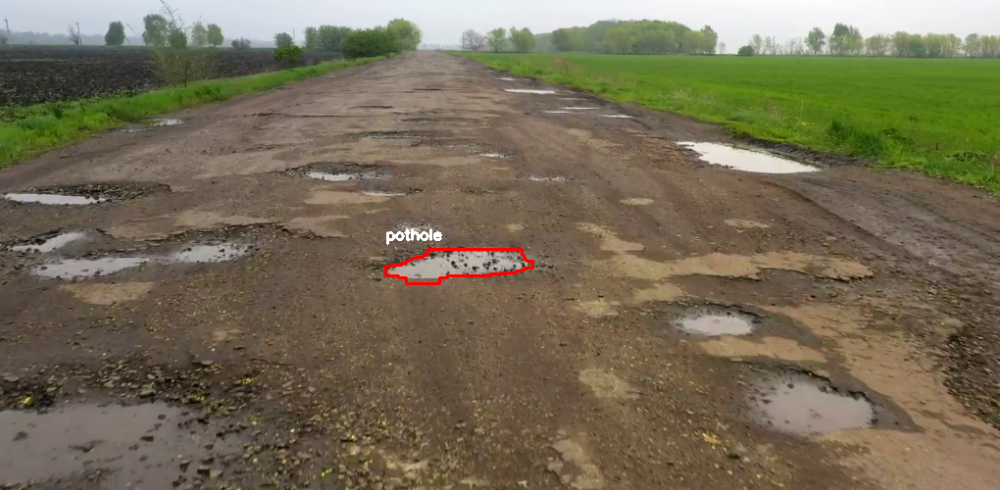


0: 320x640 1 Pothole, 2 potholes, 19.3ms
Speed: 2.4ms preprocess, 19.3ms inference, 5.1ms postprocess per image at shape (1, 3, 320, 640)


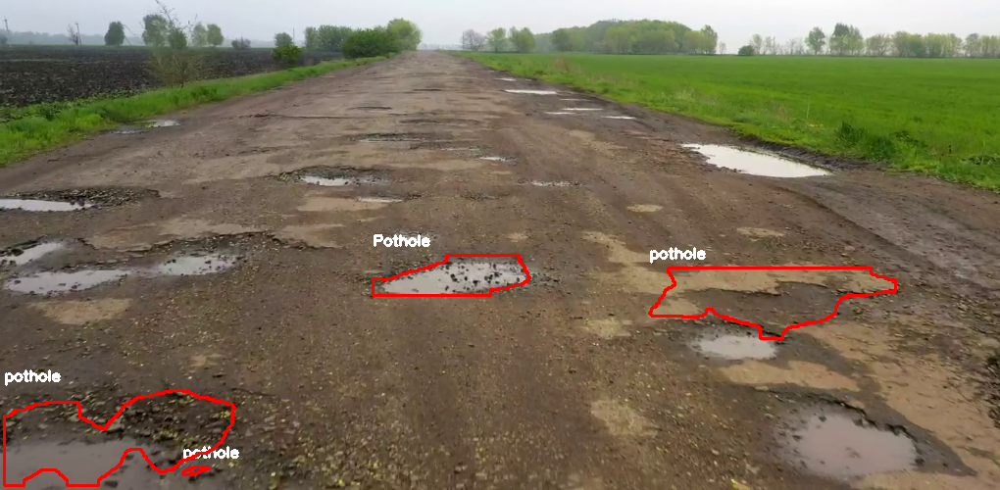


0: 320x640 1 pothole, 19.6ms
Speed: 7.8ms preprocess, 19.6ms inference, 7.6ms postprocess per image at shape (1, 3, 320, 640)


In [10]:
from ultralytics import YOLO
import cv2
import numpy as np
import cvzone
from google.colab.patches import cv2_imshow

# Load a model
model = YOLO("best.pt")
class_names = model.names
cap = cv2.VideoCapture('p.mp4')
count = 0

while True:
    ret, img = cap.read()
    if not ret:
        break
    count += 1
    if count % 3 != 0:
        continue

    img = cv2.resize(img, (1020, 500))
    h, w, _ = img.shape
    results = model.predict(img)

    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs

    if masks is not None:
        masks = masks.data.cpu()
        for seg, box in zip(masks.data.cpu().numpy(), boxes):
            seg = cv2.resize(seg, (w, h))
            contours, _ = cv2.findContours((seg).astype(np.uint8), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

            for contour in contours:
                d = int(box.cls)
                c = class_names[d]
                x, y,x1,y1 = cv2.boundingRect(contour)
                cv2.polylines(img, [contour],True, color=(0, 0, 255), thickness=2)
#                cv2.rectangle(img,(x,y),(x1+x,y1+y),(255,0,0),2)
                cv2.putText(img, c, (x,y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 2)

    cv2_imshow(img)
    if cv2.waitKey(0) & 0xFF == ord('q'):
        break

cap.release()
cv2.destroyAllWindows()
